# Using SAM3 to Blur Faces on Images

The latest version of Meta's Segment Anything Model now has the ability to take a text prompt as the input for identifying masks. One nice use case for this is automating the bluring of faces in images and videos.

In this notebook we start by bluring the face of an image. We'll then move on to bluring a face in a video. Finally, we'll move this to a serverless job for batch execution in OCI Data Science

### Load Dependencies

NOTE: You need to pip install transformers from git directly since SAM3 is a new release and not on the PyPi release of transformers

In [3]:
from transformers import pipeline
from transformers import Sam3Processor, Sam3Model
import torch
from PIL import Image
import requests

In [29]:
import numpy as np
import matplotlib


In [11]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

cuda


### Load Model

In [12]:
model = Sam3Model.from_pretrained("facebook/sam3").to(device)

Loading weights: 100%|██████████| 1468/1468 [00:01<00:00, 1145.49it/s, Materializing param=vision_encoder.neck.fpn_layers.3.proj2.weight]                       


In [13]:
processor = Sam3Processor.from_pretrained("facebook/sam3")

### Open Sample Image

In [64]:
image = Image.open('beach_run.png')

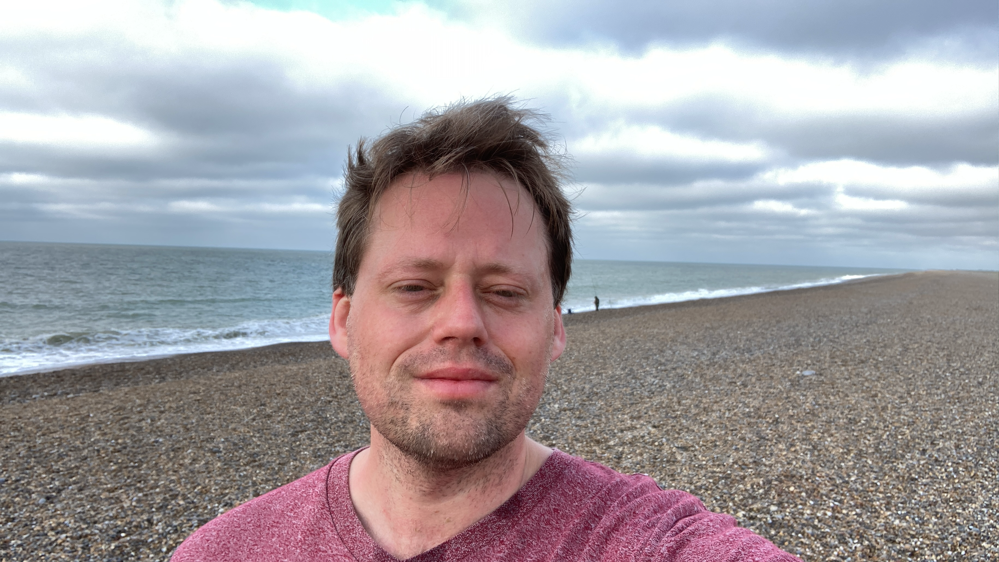

In [65]:
image

### Provide Text Prompt and Image to Model Processor

In [66]:
inputs = processor(images=image, text="face", return_tensors="pt").to(device)

### Perform Inference using Model

In [67]:
with torch.no_grad():
    outputs = model(**inputs)

### Post-Process Segmentation Results

In [68]:
results = processor.post_process_instance_segmentation(
    outputs,
    threshold=0.25,
    mask_threshold=0.25,
    target_sizes=inputs.get("original_sizes").tolist()
)[0]

### Function to Overlay Mask

In [69]:
def overlay_masks(image, masks):
    image = image.convert("RGBA")
    masks = 255 * masks.cpu().numpy().astype(np.uint8)
    
    n_masks = masks.shape[0]
    cmap = matplotlib.colormaps.get_cmap("rainbow").resampled(n_masks)
    colors = [
        tuple(int(c * 255) for c in cmap(i)[:3])
        for i in range(n_masks)
    ]

    for mask, color in zip(masks, colors):
        mask = Image.fromarray(mask)
        overlay = Image.new("RGBA", image.size, color + (0,))
        alpha = mask.point(lambda v: int(v * 0.5))
        overlay.putalpha(alpha)
        image = Image.alpha_composite(image, overlay)
    return image

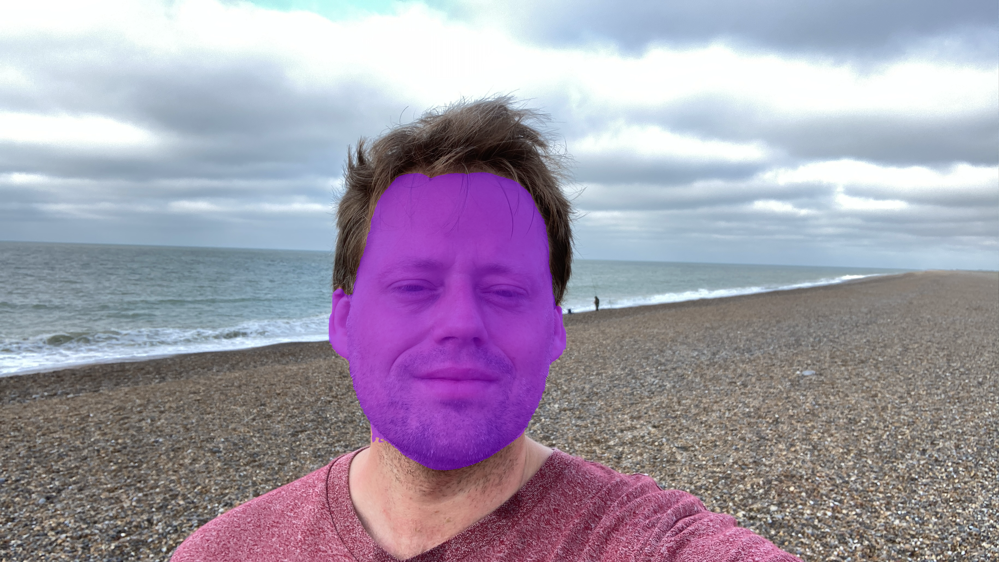

In [70]:
overlay_masks(image, results["masks"])

### Create Gaussian Blur from Mask

In [71]:
from PIL import ImageFilter

In [78]:
blurred = image.filter(ImageFilter.GaussianBlur(radius=40))  # Adjust the radius as needed


In [79]:
mask = results["masks"]

In [80]:
mask_np = mask.cpu().numpy()      # if mask is on GPU, move to CPU
if mask_np.max() <= 1.0:
    mask_np = mask_np * 255
mask_np = mask_np.astype('uint8')
if mask_np.ndim == 3:
    mask_np = mask_np.squeeze()

In [81]:
mask_img = Image.fromarray(mask_np).convert('L') 

In [82]:
result = Image.composite(blurred, image, mask_img)

### Show Transformed Image

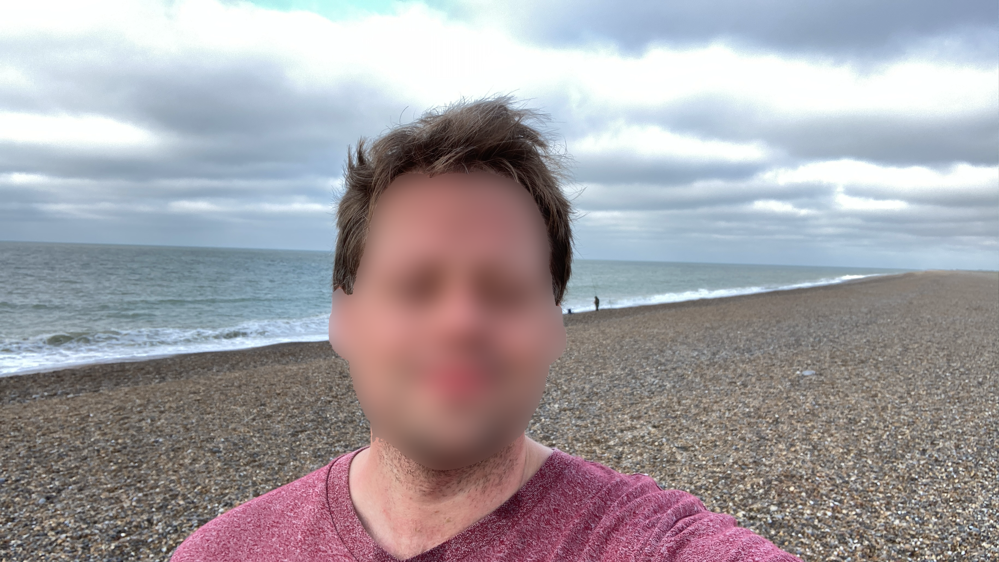

In [83]:
result